# Cellpose

github: https://github.com/mouseland/cellpose <br>
data: http://www.cellpose.org/dataset <br>
paper: http://www.cellpose.org/dataset <br>

In [1]:
import numpy as np
import time, os, sys
from urllib.parse import urlparse
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300
import cellpose
from cellpose import utils, io, models, plot
from cellpose.utils import outlines_list, masks_to_outlines
import os, sys
import glob
import cv2
from shapely.geometry import Polygon
import torch
import importlib
importlib.reload(models)

currentdir = os.path.dirname(os.path.realpath('run_cellpose.ipynb'))
parentdir = os.path.dirname(currentdir)
sys.path.append(parentdir)

Downloading: "https://www.cellpose.org/models/cyto_0" to /root/.cellpose/models/cyto_0
100%|██████████| 25.2M/25.2M [00:02<00:00, 9.32MB/s]
Downloading: "https://www.cellpose.org/models/cyto_1" to /root/.cellpose/models/cyto_1
100%|██████████| 25.2M/25.2M [00:02<00:00, 11.7MB/s]
Downloading: "https://www.cellpose.org/models/cyto_2" to /root/.cellpose/models/cyto_2
100%|██████████| 25.2M/25.2M [00:02<00:00, 10.1MB/s]
Downloading: "https://www.cellpose.org/models/cyto_3" to /root/.cellpose/models/cyto_3
100%|██████████| 25.2M/25.2M [00:02<00:00, 12.8MB/s]
Downloading: "https://www.cellpose.org/models/size_cyto_0.npy" to /root/.cellpose/models/size_cyto_0.npy
100%|██████████| 3.55k/3.55k [00:00<00:00, 10.5MB/s]
Downloading: "https://www.cellpose.org/models/cytotorch_0" to /root/.cellpose/models/cytotorch_0
100%|██████████| 25.3M/25.3M [00:02<00:00, 11.8MB/s]
Downloading: "https://www.cellpose.org/models/cytotorch_1" to /root/.cellpose/models/cytotorch_1
100%|██████████| 25.3M/25.3M [00:01

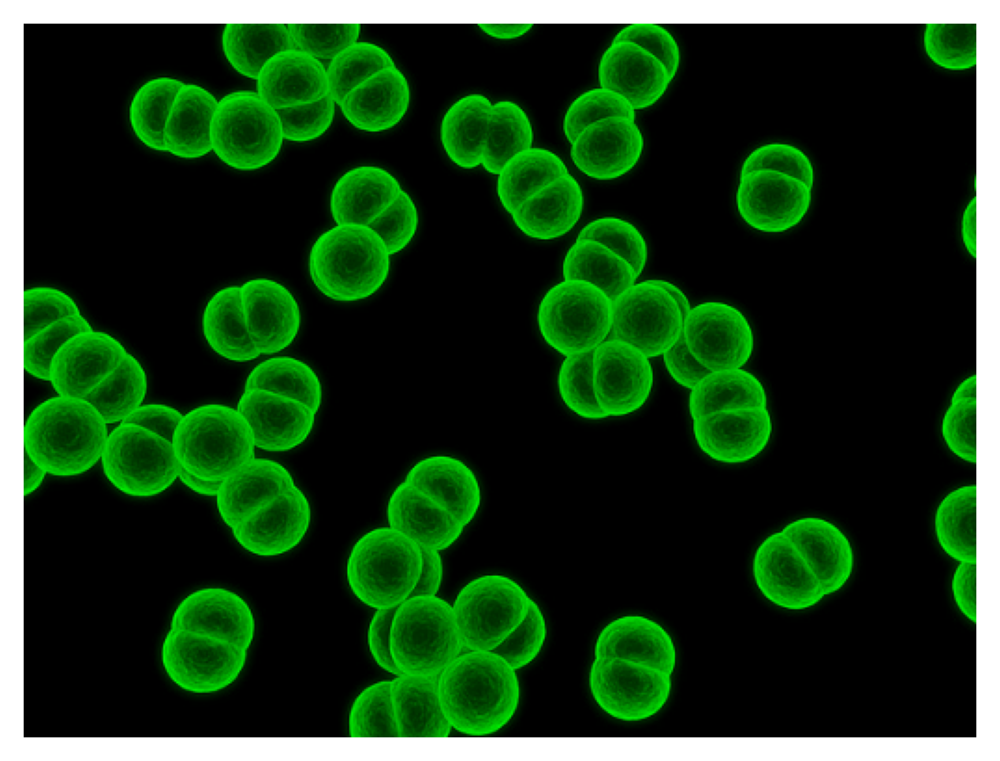

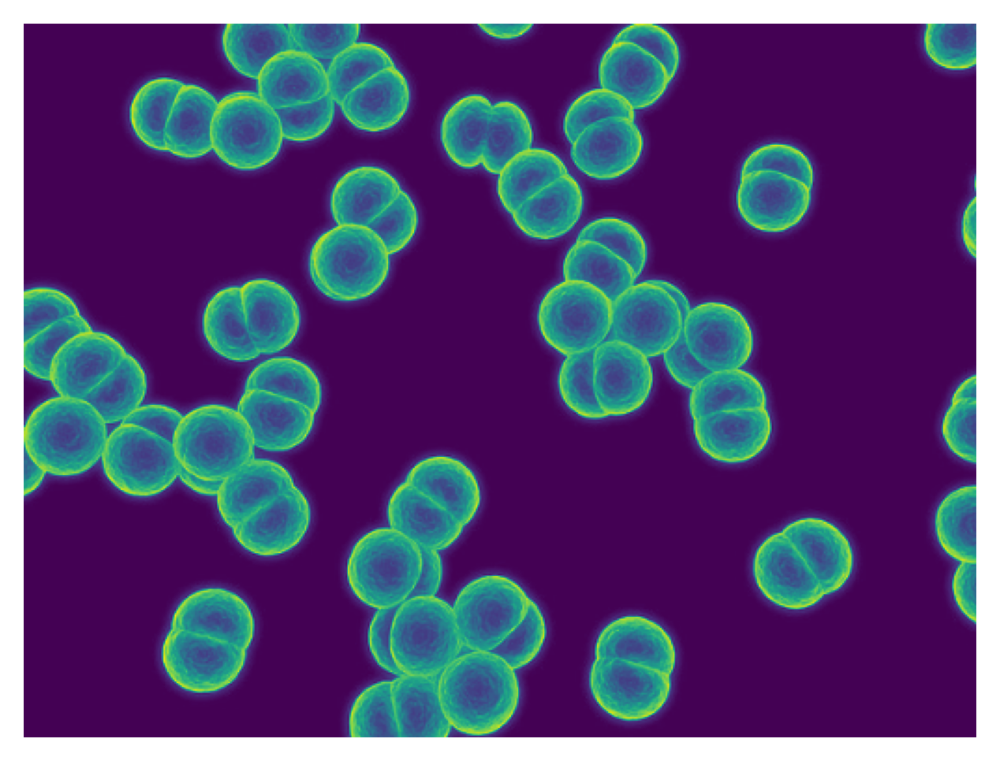

(384, 512, 3)


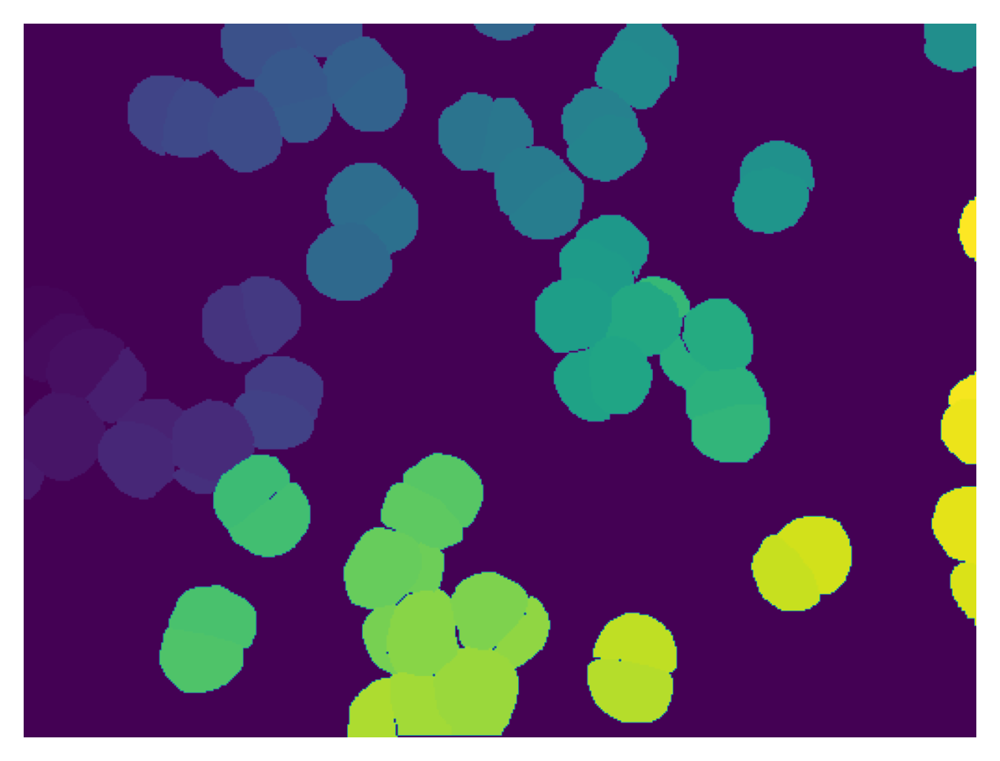

(384, 512)


In [19]:
img_f2c =plt.imread('../data/cellpose_original/train/445_img.png')
plt.imshow(img_f2c)
plt.axis('off')
plt.show()
plt.imshow(img_f2c[:,:,1])
plt.axis('off')
plt.show()
print(img_f2c.shape)
masks_f2c =plt.imread('../data/cellpose_original/train/445_masks.png')
plt.imshow(masks_f2c)
plt.axis('off')
plt.show()
print(masks_f2c.shape)

In [20]:
len(np.unique(masks_f2c))

74

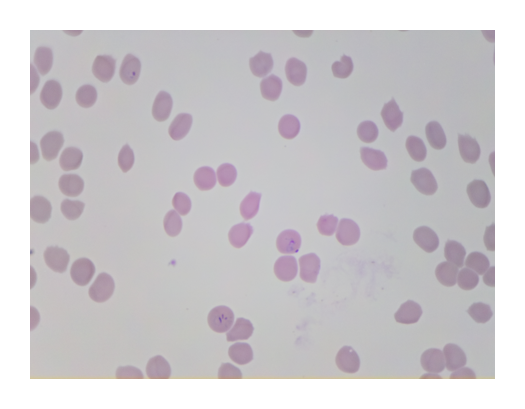

In [25]:
org_files = ['../data/Openflexure/testing_openflexure/2021-03-05_15-50-16_0_0_5578.jpeg', 
             '../data/fit_to_circle/cropped_P201_IMG_20151029_162934.png',
             '../data/fit_to_circle/cropped_P206_IMG_20151112_164625.png',
             ]

#org_files = ['../data/fit_to_circle/test/cropped_P3_IMG_20150621_112138.png',
#            '../data/fit_to_circle/train/cropped_P206_IMG_20151112_164625.png', 
#            '../data/fit_to_circle/test/cropped_P201_IMG_20151029_162934.png',
#            '../data/fit_to_circle/train/cropped_P50_IMG_20150820_162504.png'
#            ]



# view 1 image
img = io.imread(org_files[0])
plt.figure(figsize=(2,2))
plt.imshow(img)
plt.axis('off')
plt.show()

In [26]:
imgs = [cv2.imread(img_path) for img_path in org_files]

In [27]:
img_height = 1024
img_width = 1024
img_channels = 3
imgs_red = np.zeros((len(imgs), img_height, img_width, img_channels), dtype=np.uint8)
sizes_imgs_red = []
for idx, img in enumerate(imgs):
    img_red = cv2.resize(img, (img_height, img_width))
    #Append image to numpy array
    imgs_red[idx] = img_red
    #Append image shape to numpy array
    sizes_imgs_red.append([img_red.shape[0], img_red.shape[1]])

In [28]:
imgs_red[0].shape

(1024, 1024, 3)

In [29]:
diameter = None

** TORCH CUDA version installed and working. **
>>>> using GPU
processing 1 image(s)
computing styles from images
time spent: running network 0.29s; flow+mask computation 3.11
estimated cell diameters for 1 image(s) in 5.40 sec
>>> diameter(s) =  [63.14876352]
time spent: running network 0.51s; flow+mask computation 0.68
estimated masks for 1 image(s) in 1.23 sec
>>>> TOTAL TIME 6.64 sec


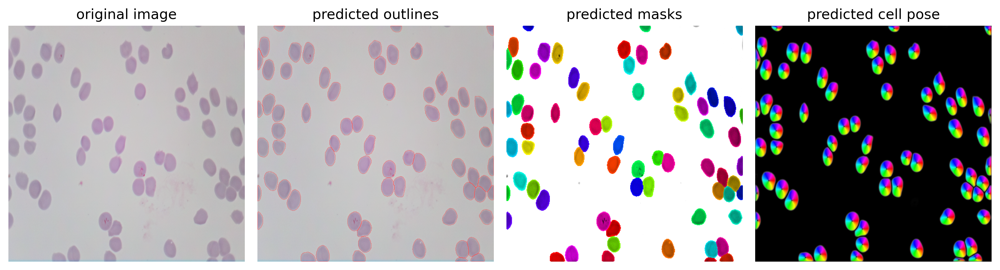

processing 1 image(s)
computing styles from images
time spent: running network 0.29s; flow+mask computation 5.57
estimated cell diameters for 1 image(s) in 8.08 sec
>>> diameter(s) =  [40.51179795]
time spent: running network 1.01s; flow+mask computation 2.39
estimated masks for 1 image(s) in 3.43 sec
>>>> TOTAL TIME 11.51 sec


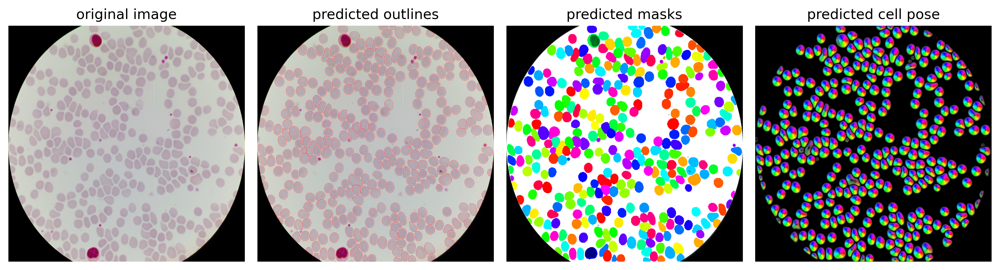

processing 1 image(s)
computing styles from images
time spent: running network 0.36s; flow+mask computation 6.82
estimated cell diameters for 1 image(s) in 9.30 sec
>>> diameter(s) =  [39.28315578]
time spent: running network 0.99s; flow+mask computation 2.46
estimated masks for 1 image(s) in 3.49 sec
>>>> TOTAL TIME 12.80 sec


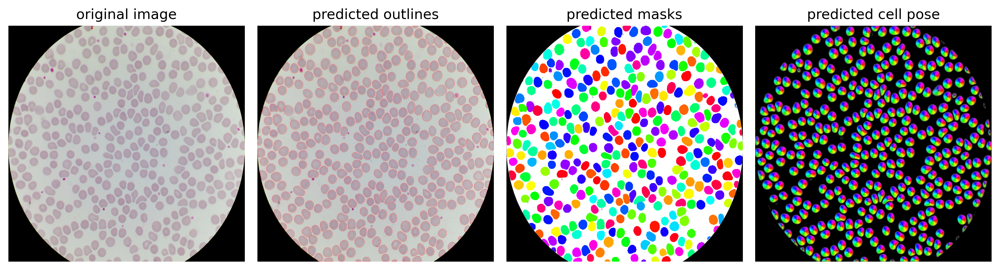

In [30]:
# RUN CELLPOSE


# DEFINE CELLPOSE MODEL
# model_type='cyto' or model_type='nuclei'
model = models.Cellpose(gpu=True, model_type='cyto')

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
# channels = [0,0] # IF YOU HAVE GRAYSCALE
# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus

# or if you have different types of channels in each image
channels = [[0,1], [0,1], [0,0]]

# if diameter is set to None, the size of the cells is estimated on a per image basis
# you can set the average cell `diameter` in pixels yourself (recommended) 
# diameter can be a list or a single number for all images

# you can run all in a list e.g.
# >>> imgs = [io.imread(filename) in files]
# >>> masks, flows, styles, diams = model.eval(imgs, diameter=None, channels=channels)
# >>> io.masks_flows_to_seg(imgs, masks, flows, diams, files, channels)
# >>> io.save_to_png(imgs, masks, flows, files)

# or in a loop
# for chan, img in zip(channels, imgs_red):
masks_all = []

for img in imgs_red:
    chan = [0, 0] # for black and white imgs
    #img = io.imread(filename)
    masks, flows, styles, diams = model.eval(img, 
                                 diameter= diameter, 
                                 channels=chan,
                                 invert = True,
                                 flow_threshold = 1,
                                 #cellprob_threshold = -2,
                                                )

    masks_all.append(masks)
    
    # # save results so you can load in gui
    # io.masks_flows_to_seg(img, masks, flows, diams, filename, chan)

    # # save results as png
    # io.save_to_png(img, masks, flows, filename)
    
    # DISPLAY RESULTS

    fig = plt.figure(figsize=(12,5))
    plot.show_segmentation(fig, img, masks, flows[0], channels=chan)
    plt.tight_layout()
    plt.show()

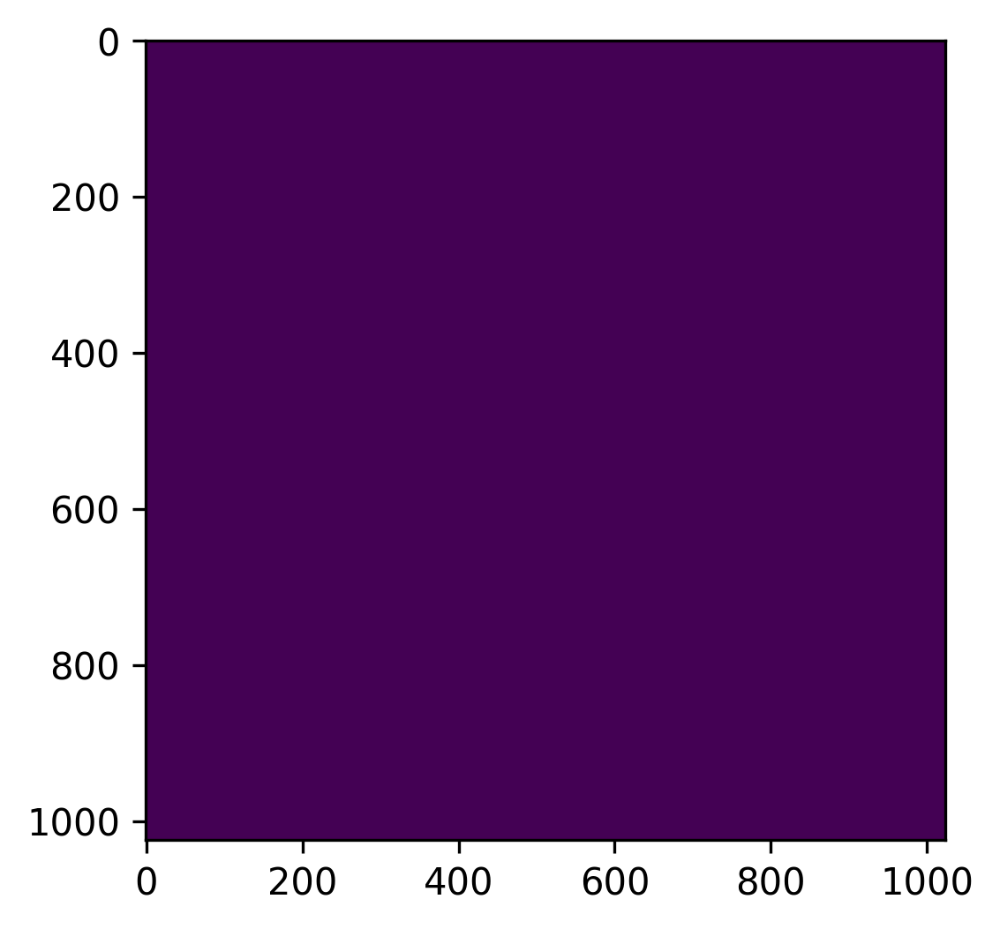

In [16]:
plt.imshow(masks)

(-0.5, 1023.5, 1023.5, -0.5)

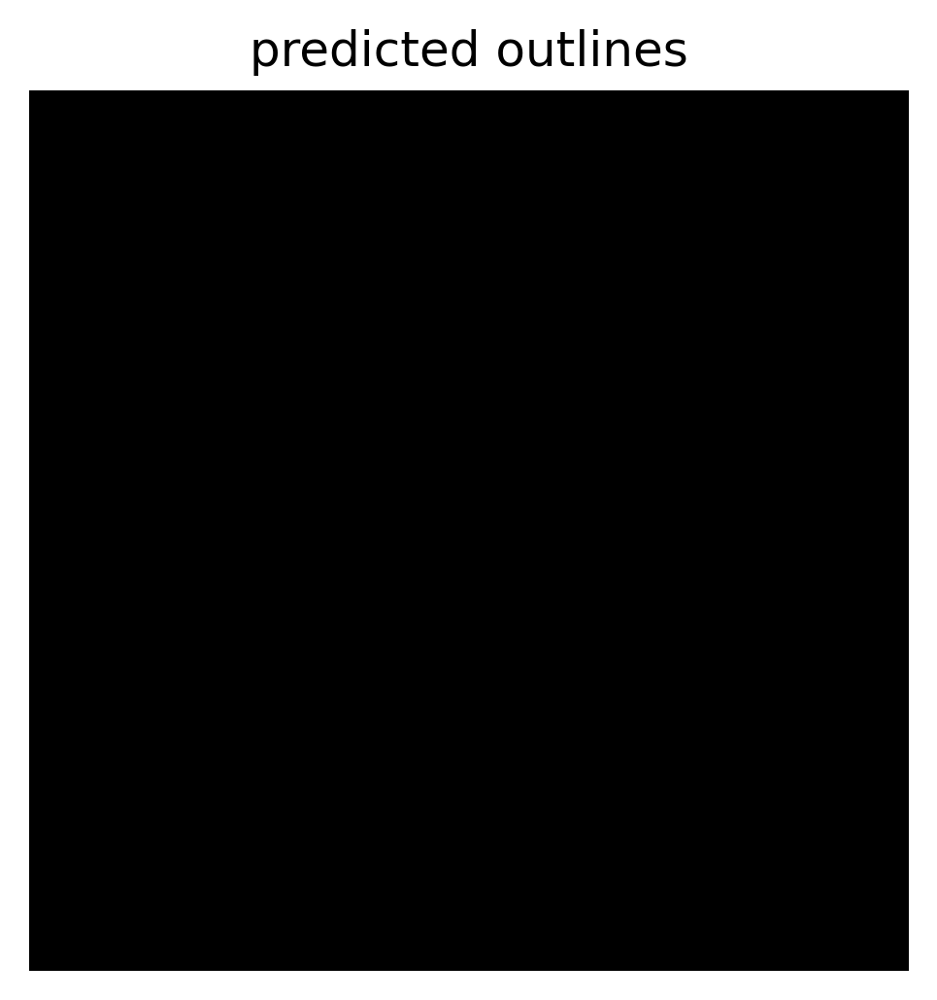

In [17]:
fig = plt.figure()
ax = fig.add_subplot(111)
outlines = utils.masks_to_outlines(masks_all[-3])
outX, outY = np.nonzero(outlines)
imgout= imgs_red[-3].copy()
imgout[outX, outY] = np.array([255,75,75])
ax.imshow(imgout)
#for o in outpix:
#    ax.plot(o[:,0], o[:,1], color=[1,0,0], lw=1)
ax.set_title('predicted outlines')
ax.axis('off')

In [45]:
outlines_ls = np.array(outlines_list(masks))
outlines_ls[0]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  """Entry point for launching an IPython kernel.


array([[440,   6],
       [439,   7],
       [438,   7],
       [437,   7],
       [436,   7],
       [435,   7],
       [434,   7],
       [433,   7],
       [432,   7],
       [431,   8],
       [430,   8],
       [429,   8],
       [428,   8],
       [427,   8],
       [426,   8],
       [425,   8],
       [424,   8],
       [424,   9],
       [423,  10],
       [422,  10],
       [421,  10],
       [420,  10],
       [419,  10],
       [418,  11],
       [417,  11],
       [416,  11],
       [415,  11],
       [414,  12],
       [413,  12],
       [412,  12],
       [412,  13],
       [412,  14],
       [411,  15],
       [411,  16],
       [411,  17],
       [411,  18],
       [411,  19],
       [411,  20],
       [411,  21],
       [412,  22],
       [412,  23],
       [412,  24],
       [412,  25],
       [413,  25],
       [414,  26],
       [414,  27],
       [415,  28],
       [415,  29],
       [415,  30],
       [416,  31],
       [417,  31],
       [418,  32],
       [418,

# Retrain with NIH Data

In [17]:
torch.cuda.get_device_name(0)

'GeForce GTX 1080 Ti'

https://github.com/MouseLand/cellpose/blob/5cc03de9c2aa342d4b4469ff476ca04541b63414/docs/train.rst

Following the comments of https://github.com/MouseLand/cellpose/issues/211 <br>
I changed line 316 of /usr/local/lib/python3.6/dist-packages/cellpose/models.py to <br>
   def __init__(self, **gpu=True**, pretrained_model=False, torch=True, ...

In [18]:
#Settings
# --check_mkl', action='store_true', help='check if mkl working'

#'--mkldnn', action='store_true', help='for mxnet, force MXNET_SUBGRAPH_BACKEND = "MKLDNN"')

#'--train', action='store_true', help='train network using images in dir')
#'--dir', required=False, help='folder containing data to run or train on')
#  '--mxnet', action='store_true', help='use mxnet')
#  '--img_filter', required=False, default=[], type=str, help='end string for images to run on')
#  '--use_gpu', action='store_true', help='use gpu if mxnet with cuda installed')
#   '--fast_mode', action='store_true', help="make code run faster by turning off 4 network averaging")
#  '--resample', action='store_true', help="run dynamics on full image (slower for images with large diameters)")
# '--no_interp', action='store_true', help='do not interpolate when running dynamics (was default)')
#  '--do_3D', action='store_true',  help='process images as 3D stacks of images (nplanes x nchan x Ly x Lx')
   
# settings for training
#    parser.add_argument('--train_size', action='store_true', help='train size network at end of training')
#    parser.add_argument('--mask_filter', required=False, default='_masks', type=str, help='end string for masks to run on')
#    parser.add_argument('--test_dir', required=False, default=[], type=str, help='folder containing test data (optional)')
#    parser.add_argument('--learning_rate', required=False, default=0.2, type=float, help='learning rate')
#    parser.add_argument('--n_epochs', required=False, default=500, type=int, help='number of epochs')
#    parser.add_argument('--batch_size', required=False, default=8, type=int, help='batch size')
#    parser.add_argument('--residual_on', required=False, default=1, type=int, help='use residual connections')
#    parser.add_argument('--style_on', required=False, default=1, type=int, help='use style vector')
#    parser.add_argument('--concatenation', required=False, dfault=0, type=int, help='concatenate downsampled layers with upsampled layers (off by default which means they are added)')


### Sanity check with cellpose original images

In [30]:
!python -m cellpose \
--train \
--use_gpu \
--dir ../data/cellpose_original/train/ \
--test_dir ../data/cellpose_original/test/ \
--n_epochs 10 \
--img_filter _img \
--learning_rate 0.0002 \
--pretrained_model cyto 

** TORCH CUDA version installed and working. **
>>>> using GPU
>>>> pretrained model /root/.cellpose/models/cytotorch_0 is being used
>>>> during training rescaling images to fixed diameter of 30.0 pixels
flows precomputed
flows precomputed
>>>> training network with 2 channel input <<<<
>>>> saving every 100 epochs
>>>> median diameter = 30
>>>> LR: 0.00020, batch_size: 8, weight_decay: 0.00001
>>>> ntrain = 540
>>>> ntest = 68
(2, 383, 512)
Epoch 0, Time 13.5s, Loss 0.8991, Loss Test 1.1082, LR 0.0000
Epoch 1, Time 27.1s, Loss 0.9003, Loss Test 1.1097, LR 0.0000
saving network parameters
Epoch 2, Time 40.8s, Loss 0.9038, Loss Test 1.1032, LR 0.0000
Epoch 3, Time 54.7s, Loss 0.8942, Loss Test 1.0906, LR 0.0001
Epoch 4, Time 68.3s, Loss 0.9226, Loss Test 1.1002, LR 0.0001
Epoch 5, Time 81.9s, Loss 0.8888, Loss Test 1.1019, LR 0.0001
Epoch 6, Time 95.6s, Loss 0.8870, Loss Test 1.0823, LR 0.0001
Epoch 7, Time 109.2s, Loss 0.9011, Loss Test 1.0922, LR 0.0002
Epoch 8, Time 122.9s, Loss 0.8

../data/cellpose_original/train/models/cellpose_residual_on_style_on_concatenation_off_train_2021_04_22_11_42_59.984760
parsing model string to get cellpose options
** TORCH CUDA version installed and working. **
>>>> using GPU
time spent: running network 0.31s; flow+mask computation 3.55


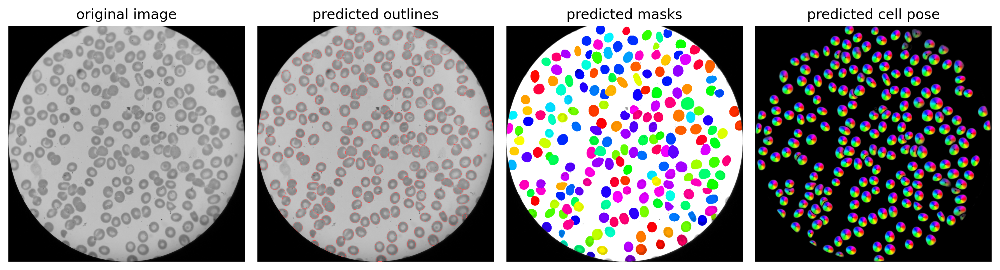

time spent: running network 0.30s; flow+mask computation 4.01


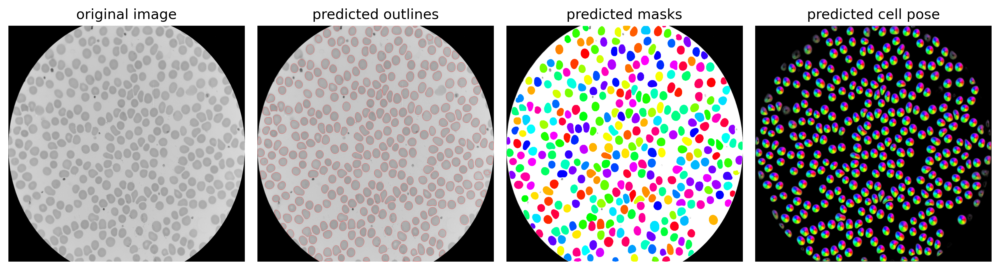

time spent: running network 0.29s; flow+mask computation 4.12


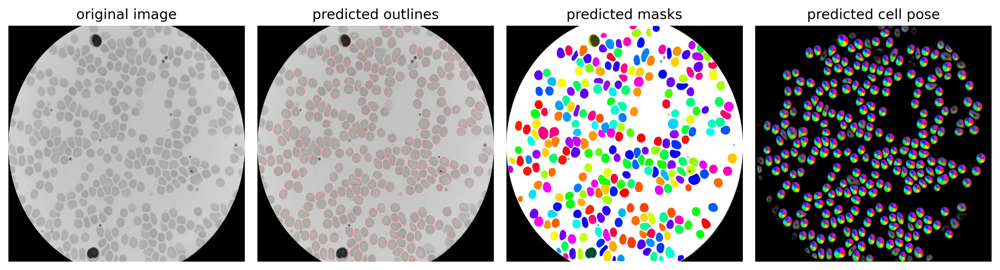

time spent: running network 0.29s; flow+mask computation 3.09


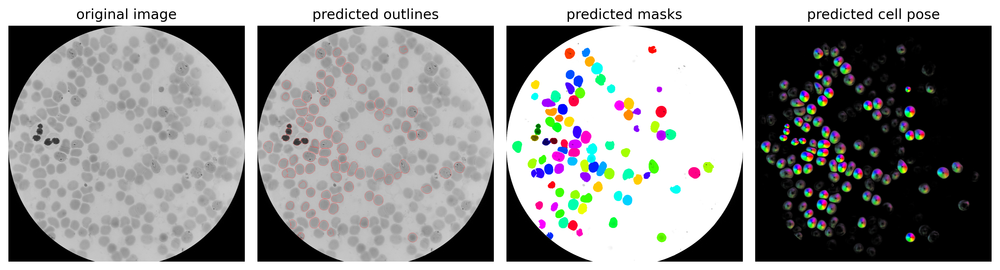

In [51]:
list_of_files = glob.glob('../data/cellpose_original/train/models/*') # * means all if need specific format then *.csv
latest_file = max(list_of_files, key=os.path.getctime)
#latest_file = '../data/cellpose_original/train/models/cellpose_residual_on_style_on_concatenation_off_train_2021_04_22_10_33_34.919807'
print(latest_file)
model = models.CellposeModel(gpu=True, pretrained_model=latest_file, torch=False, diam_mean=30.0, net_avg=True, device=None, residual_on=True, style_on=True, concatenation=False)
#model = models.Cellpose(gpu=True, model_type='cyto')

masks_all = []

for img in imgs_red:
    chan = [0, 0] # for black and white imgs
    #img = io.imread(filename)
    masks, flows, styles = model.eval(img, diameter=30, channels=chan)

    masks_all.append(masks)
    
    # DISPLAY RESULTS

    fig = plt.figure(figsize=(12,5))
    plot.show_segmentation(fig, img, masks, flows[0], channels=chan)
    plt.tight_layout()
    plt.show()


In [24]:
!python -m cellpose \
--train \
--use_gpu \
--dir ../data/fit_to_circle/train/ \
--test_dir ../data/fit_to_circle/test/ \
--pretrained_model None \
--learning_rate 0.0002 \
--n_epochs 1000 \
--diameter 45 

** TORCH CUDA version installed and working. **
>>>> using GPU
>>>> training from scratch
>>>> during training rescaling images to fixed diameter of 30.0 pixels
flows precomputed
flows precomputed
/usr/local/lib/python3.6/dist-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
>>>> training network with 2 channel input <<<<
>>>> saving every 100 epochs
>>>> median diameter = 30
>>>> LR: 0.20000, batch_size: 8, weight_decay: 0.00001
>>>> ntrain = 132
>>>> ntest = 33
(2, 1024, 1024)
Epoch 0, Time  4.3s, Loss 0.7316, Loss Test 0.7097, LR 0.0000
Epoch 1, Time  8.5s, Loss 0.2013, Loss Test 0.0506, LR 0.0222
saving network parameters
Epoch 2, Time 12.7s, Loss 0.0326, Loss Test 0.0172, LR 0.0444
Epoch 3, Time 16.9s, Loss 0.0174, Loss Test 0.0131, LR 0.0667
Epoch 4, Time 21.1s, Loss 0.

parsing model string to get cellpose options
** TORCH CUDA version installed and working. **
>>>> using GPU
time spent: running network 0.07s; flow+mask computation 0.46
time spent: running network 0.07s; flow+mask computation 0.45
time spent: running network 0.08s; flow+mask computation 0.44
time spent: running network 0.07s; flow+mask computation 0.44


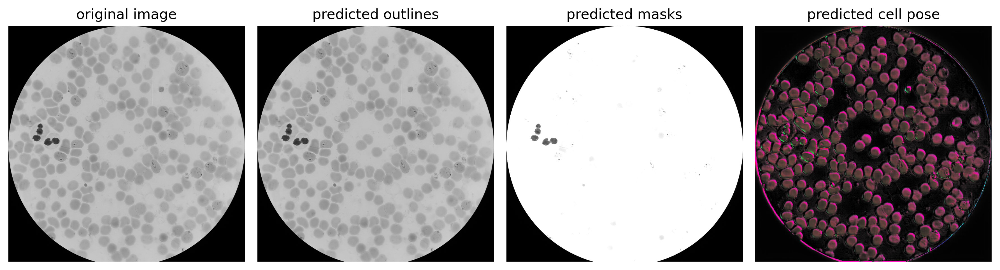

In [27]:
list_of_files = glob.glob('../data/fit_to_circle/train/models/*') # * means all if need specific format then *.csv
#latest_file = max(list_of_files, key=os.path.getctime)
latest_file = '../data/fit_to_circle/train/models/cellpose_residual_on_style_on_concatenation_off_train_2021_04_22_08_46_03.986924'
model = models.CellposeModel(gpu=True, pretrained_model=latest_file, torch=False, diam_mean=30.0, net_avg=True, device=None, residual_on=True, style_on=True, concatenation=False)

masks_all = []

for img in imgs:
    chan = [0, 0] # for black and white imgs
    #img = io.imread(filename)
    masks, flows, styles = model.eval(img, diameter=60, channels=chan)

    masks_all.append(masks)

# DISPLAY RESULTS

fig = plt.figure(figsize=(12,5))
plot.show_segmentation(fig, img, masks, flows[0], channels=chan)
plt.tight_layout()
plt.show()

In [43]:
!python -m cellpose \
--train \
--use_gpu \
--dir ../data/fit_to_circle/train_512/ \
--test_dir ../data/fit_to_circle/test_512/ \
--pretrained_model cyto \
--learning_rate 0.0002 \
--n_epochs 200

** TORCH CUDA version installed and working. **
>>>> using GPU
^C
Traceback (most recent call last):
  File "/usr/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/usr/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/usr/local/lib/python3.6/dist-packages/cellpose/__main__.py", line 258, in <module>
    main()
  File "/usr/local/lib/python3.6/dist-packages/cellpose/__main__.py", line 188, in main
    output = io.load_train_test_data(args.dir, test_dir, imf, args.mask_filter, args.unet)
  File "/usr/local/lib/python3.6/dist-packages/cellpose/io.py", line 127, in load_train_test_data
    flows = imread(flow_names[n])
  File "/usr/local/lib/python3.6/dist-packages/cellpose/io.py", line 40, in imread
    img = tifffile.imread(filename)
  File "/usr/local/lib/python3.6/dist-packages/tifffile/tifffile.py", line 721, in imread
    return tif.asarray(**kwargs)
  File "/usr/local/lib/python3.6/dist-packages/tifffile/ti

parsing model string to get cellpose options
** TORCH CUDA version installed and working. **
>>>> using GPU
time spent: running network 0.27s; flow+mask computation 1.68
time spent: running network 0.28s; flow+mask computation 1.78
time spent: running network 0.27s; flow+mask computation 1.66
time spent: running network 0.26s; flow+mask computation 1.63


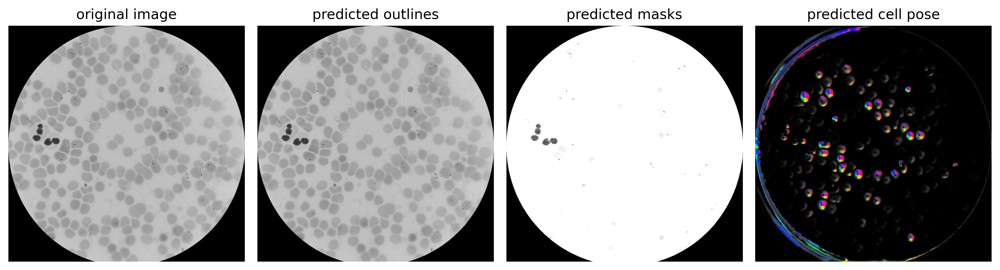

In [141]:
custom_model_path = '../data/fit_to_circle/train_512/models/cellpose_residual_on_style_on_concatenation_off_train_512_2021_04_18_13_44_09.948435'
model = models.CellposeModel(gpu=True, pretrained_model=custom_model_path, torch=False, diam_mean=30.0, net_avg=True, device=None, residual_on=True, style_on=True, concatenation=False)

masks_all = []

for img in imgs_red:
    chan = [0, 0] # for black and white imgs
    #img = io.imread(filename)
    masks, flows, styles = model.eval(img, diameter=30, channels=chan)

    masks_all.append(masks)

# DISPLAY RESULTS

fig = plt.figure(figsize=(12,5))
plot.show_segmentation(fig, img, masks, flows[0], channels=chan)
plt.tight_layout()
plt.show()